### Setup 

In [1]:
import pandas as pd
import numpy as np
# 
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px
from dataprep.eda import plot
# 

import warnings
warnings.filterwarnings('ignore')


In [2]:
# path in my pc
PATH = r'E:\_Projects\_Final Projects\Black_Friday_Sales\ignoreFiles\train.csv'
df = pd.read_csv(PATH , encoding='utf-8',sep=',')

### Understand Data

In [3]:
df.sample(20)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
466743,1005888,P00252042,M,26-35,20,B,1,0,5,14.0,NaN,3585
53829,1002186,P00346342,M,18-25,5,C,4+,0,1,15.0,NaN,11719
359694,1001387,P00202742,F,51-55,13,B,1,1,5,13.0,14.0,6908
524017,1002765,P00339942,M,51-55,7,C,1,1,1,NaN,NaN,15895
256503,1003569,P00305042,F,18-25,2,B,1,0,11,13.0,16.0,1601
94772,1002649,P00220442,M,26-35,16,C,2,0,5,14.0,NaN,7119
262007,1004337,P00246742,M,18-25,20,C,4+,0,11,15.0,NaN,6128
46204,1001125,P00148842,F,18-25,4,B,2,0,6,8.0,16.0,12018
265147,1004819,P00025042,M,36-45,18,B,1,0,5,15.0,NaN,5398
518002,1001753,P00184442,M,36-45,6,B,3,0,1,6.0,8.0,11527


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 12 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   User_ID                     550068 non-null  int64  
 1   Product_ID                  550068 non-null  object 
 2   Gender                      550068 non-null  object 
 3   Age                         550068 non-null  object 
 4   Occupation                  550068 non-null  int64  
 5   City_Category               550068 non-null  object 
 6   Stay_In_Current_City_Years  550068 non-null  object 
 7   Marital_Status              550068 non-null  int64  
 8   Product_Category_1          550068 non-null  int64  
 9   Product_Category_2          376430 non-null  float64
 10  Product_Category_3          166821 non-null  float64
 11  Purchase                    550068 non-null  int64  
dtypes: float64(2), int64(5), object(5)
memory usage: 50.4+ MB


In [5]:
df.describe(include="object")


,Product_ID,Gender,Age,City_Category,Stay_In_Current_City_Years
count,550068,550068,550068,550068,550068
unique,3631,2,7,3,5
top,P00265242,M,26-35,B,1
freq,1880,414259,219587,231173,193821


<AxesSubplot: >

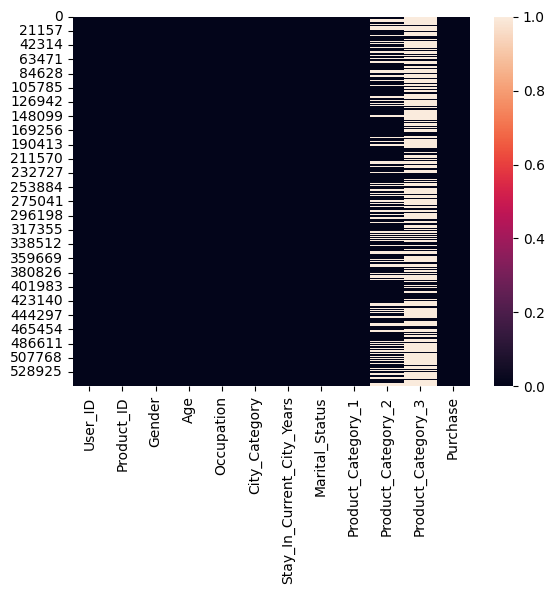

In [6]:
sns.heatmap(df.isnull())

In [7]:
# fill missing values in  --> 'Product_Category_2', 'Product_Category_3'
df.fillna(0, inplace=True)

In [8]:
# convert data types 
columns_to_convert = ['Product_Category_2', 'Product_Category_3']
df[columns_to_convert] = df[columns_to_convert].astype(int)


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 12 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   User_ID                     550068 non-null  int64 
 1   Product_ID                  550068 non-null  object
 2   Gender                      550068 non-null  object
 3   Age                         550068 non-null  object
 4   Occupation                  550068 non-null  int64 
 5   City_Category               550068 non-null  object
 6   Stay_In_Current_City_Years  550068 non-null  object
 7   Marital_Status              550068 non-null  int64 
 8   Product_Category_1          550068 non-null  int64 
 9   Product_Category_2          550068 non-null  int32 
 10  Product_Category_3          550068 non-null  int32 
 11  Purchase                    550068 non-null  int64 
dtypes: int32(2), int64(5), object(5)
memory usage: 46.2+ MB


In [10]:
df['Purchase'].describe()


count    550068.000000
mean       9263.968713
std        5023.065394
min          12.000000
25%        5823.000000
50%        8047.000000
75%       12054.000000
max       23961.000000
Name: Purchase, dtype: float64

In [11]:
px.box(df,y='Purchase')

In [12]:
len(df[df['Purchase'] > 21000])

3541

<hr>

## EDA 

### Gender 

In [14]:
px.pie(df,values = 'Purchase',names='Gender',title='The gender that has the most purchases')